# Single Cell Sequencing
## Gene exploration


Uses exon data extracted from: zUMIs_output\expression\*.dgecounts.rds and gene data from: zUMIs_output\expression\*.gene_names.txt<br>


In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy
import anndata as ad
import hdf5plugin
from sklearn.decomposition import TruncatedSVD
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import rcParams
import os 
#external modules
#pretty plotting
import seaborn as sb
import sys 
sb.set_context(context='poster')

import copy

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80)

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\umap\distances.py:1086: NumbaDeprecationWarni

scanpy==1.9.3 anndata==0.9.2 umap==0.5.3 numpy==1.24.4 scipy==1.10.1 pandas==2.0.3 scikit-learn==1.3.0 statsmodels==0.14.0 python-igraph==0.10.6 louvain==0.8.1 pynndescent==0.5.10


c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\umap\umap_.py:660: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()


## Data loading


In [69]:
figure_path = r'C:\Users\ilosz01\OneDrive - Linköpings universitet\MarcinLab\SingleCellSequencing\scs_analysis\figuresR'
input_path = r'C:\Users\ilosz01\OneDrive - Linköpings universitet\MarcinLab\SingleCellSequencing\scs_analysis\out'


adata_umap_path = os.path.join(input_path,'control_scs_umap_from_R.h5ad')
adata_path = os.path.join(input_path,'campari_scs_from_R.h5ad')


NO_PCA = 20
SELECTED_LOUVAIN = 'louvain_r1'


In [70]:
adata_umap = ad.read_h5ad(adata_umap_path)

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\anndata\_core\anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


## Explore Genes

In [71]:
### Define list of relevant genes 

marker_genes = ['Trpm3','Piezo2','Trpm2','Smr2','Sstr2','Bmpr1b','Trpm8','Trpv1','Piezo2','Piezo1','Nppb',
                'Sst','Pvalb','Prokr2','Mrgprd','Mrgpra3','Cd34',
                'Th','Trpa1','Ntrk3','Ntrk2','Ntrk1','Ret','Tac1','Calca','Calcb','Nefh',
                'S100b','Scn10a','Slc17a8','Atf3','Pou4f3','Calb1','Calb2','Avil','Asic3',
                'Asic2','Asic1','Pou6f2','Avpr1a','Pou4f2','Sox10','Casq2','Chrna7','Chrna3',
                'P2rx3','Gfra2','Ldhb','Necab2','Spp1','Adm','Hpse']

In [72]:
# ### Run plotting umap with color code according to gene expression
# rcParams['figure.figsize']=(4,4)

# np.in1d(marker_genes, adata_umap.var_names)
# for gene in marker_genes:
#     # sc.pl.umap(adata=adata_umap, color=gene, use_raw=False, cmap = 'rainbow',save = '_expression_genes_' + gene + '.png', size = 80)
#     sc.pl.umap(adata=adata_umap, color=gene, use_raw=False, cmap = 'rainbow', size = 80)
    

## Finding marker genes

In [73]:
adata_umap

AnnData object with n_obs × n_vars = 989 × 25990
    obs: 'barcode', 'stimulus', 'red', 'green', 'well_id', 'batch', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'louvain_r0.5', 'louvain_r1', 'louvain_r1.5', 'louvain_r2', 'louvain_r2.5'
    var: 'gene_id', 'gene_name', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'louvain', 'louvain_r0.5_colors', 'louvain_r1.5_colors', 'louvain_r1_colors', 'louvain_r2.5_colors', 'louvain_r2_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [74]:
sc.pp.log1p(adata_umap) # it was already logaritmized but adata.uns['log1p'] has no 'base' key

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\preprocessing\_simple.py:352: RuntimeWarning: invalid value encountered in log1p
  np.log1p(X, out=X)


In [75]:
adata_umap.uns['log1p']

{'base': None}

In [76]:
sc.tl.rank_genes_groups(adata_umap,SELECTED_LOUVAIN, use_raw=False, method='wilcoxon')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
c:\Users\ilosz01\.conda\e

In [77]:
pd.DataFrame(adata_umap.uns['rank_genes_groups']['names']).head(10) # louvain_r2 has 0-12 clasters (column names are clusters)

,0,1,2,3,4,5,6,7,8,9,10
0,Adcyap1,Mrgprd,Cd34,Mrap2,Tbx3os2,Gm5517,P2rx6,Asic3,Mrgpra3,Relt,Il31ra
1,Gal,Prkcq,Tafa4,Negr1,Baiap2l1,Sox5os2,Cabp7,Abcg2,Mrgprx1,Whrn,Osmr
2,Gpx3,Ptprt,Gm7271,Pcsk1,Cadps2,Gm37669,Lgi3,Cgnl1,Adora2b,Pvalb,Htr1f
3,Trpv1,Rab27b,D130079A08Rik,Pou4f3,Tbx3,Slitrk6,Tesc,Gng8,Rspo1,Hs3st2,Gpr139
4,Rxrg,Rspo2,Wfdc2,Lrguk,Necab2,Gm12389,Clrn1,Serpinb1a,Tmprss11c,Sh3bgr,Ptprk
5,Atp2b4,Mmp25,Th,Chst2,Lgi2,Gm48885,Pls1,Kcnv1,Krt27,Pth1r,Stom
6,Bex1,Fam167a,Smyd1,Arhgap6,Kcnq3,Gm27415,Tmem163,Hopx,Cfap61,Runx3,Cysltr2
7,Cacna1e,Trpc3,Cdh9,Esr1,Kcnc4,Gm16288,Hhatl,Ly6h,Mical1,Ano1,Nts
8,Kcnmb2,Sdc1,Rgs8,Rab3b,Tafa3,4831440D22Rik,Syt3,Nptx1,Hrh1,Slit2,Mical1
9,Kcnk3,Arap1,Gm47913,Hmgn5,Slc6a19,Olfr921,Bcat1,Prkcb,Gda,Lhfpl1,Pde4c


In [78]:
marker_genes_dict = {
    'RA-LTMR': ['Ntrk2'],
    'C-LTMR': ['Cd34', 'Th'],
    'Itch': ['Nppb','Mrgpra3'],
    'Nonpeptidergic-Nociceptors': ['Mrgprd'],
    'Peptidergic-Nociceptors': ['Sstr2'],
    'Interoceptors': ['Adra2a','Tac1'],
    'A-HTMR': ['Smr2','Bmpr1b'],
    'Propioceptores': ['Pvalb']
}

In [79]:
len(adata_umap.var_names)

25990

In [80]:
# there are some gene name duplicates
def unique(list1):
 
    # initialize a null list
    unique_list = []
    unique_index = []
 
    # traverse for all elements
    count = 0
    for x in list1:
        # check if exists in unique_list or not
        if x not in unique_list:
            unique_list.append(x)
            unique_index.append(count)
        count+=1
    return unique_list,unique_index
        
gene_name = []
for i in range(len(adata_umap.var['gene_name'])):
    gene_name.append(adata_umap.var['gene_name'].iloc[i])


In [81]:
# remove duplicates
unique_genes , unique_genes_index = unique(gene_name)

adata_umap = adata_umap[:,np.array(unique_genes_index)]

In [82]:
len(adata_umap.var_names)

25966

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


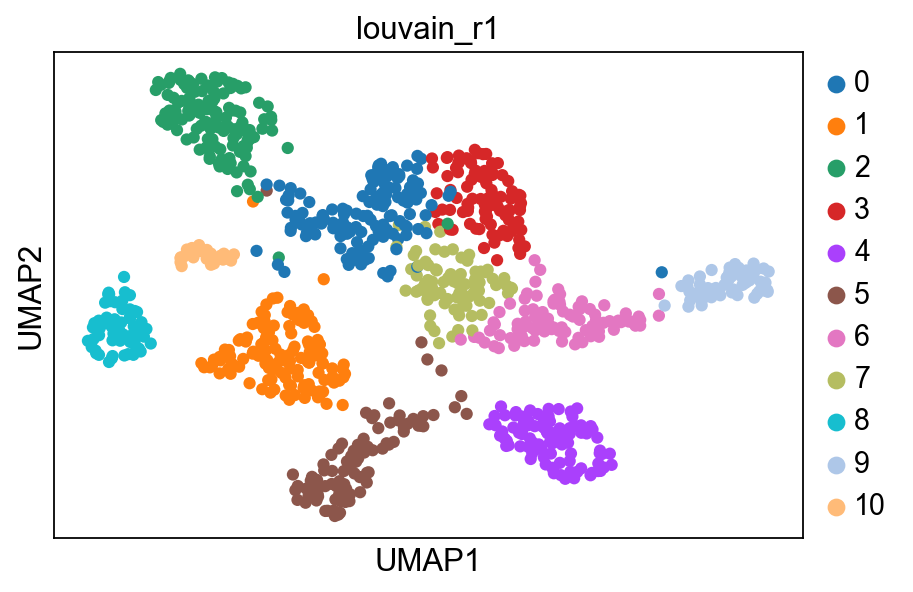

In [83]:
# show which claster is which
rcParams['figure.figsize']=(6,4)
sc.pl.umap(adata_umap, color=SELECTED_LOUVAIN, use_raw=False)

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


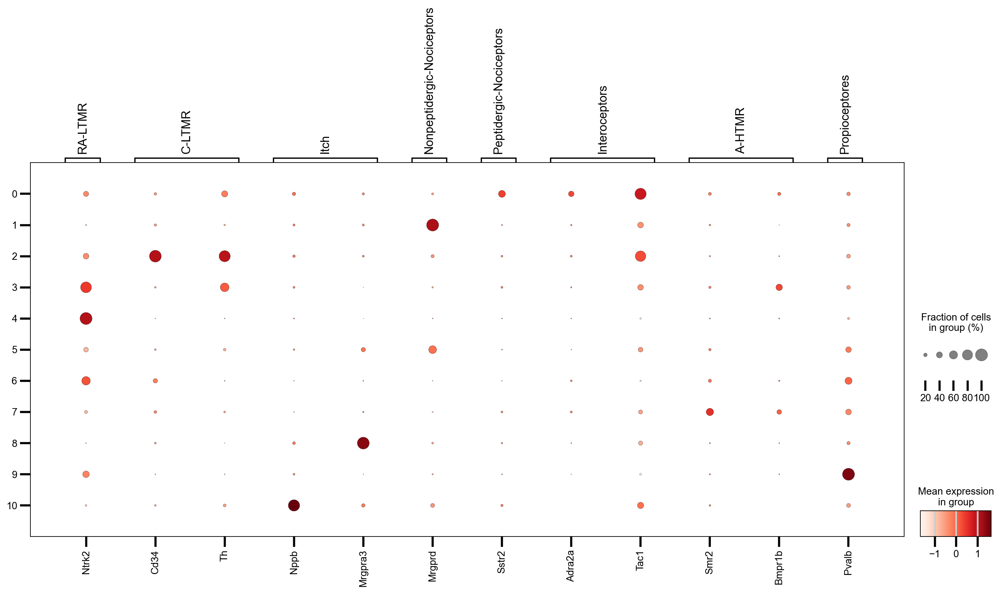

In [84]:

sc.pl.dotplot(adata_umap, marker_genes_dict, use_raw=False, groupby=SELECTED_LOUVAIN, figsize=(20,8))

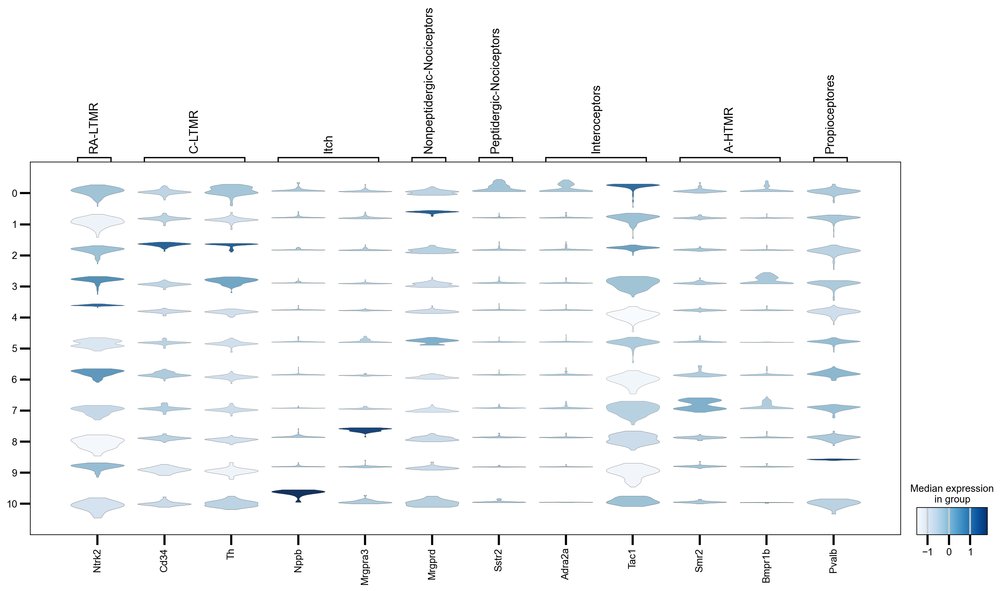

In [85]:
sc.pl.stacked_violin(adata_umap, marker_genes_dict, use_raw=False, groupby=SELECTED_LOUVAIN, figsize=(20,8),rotation=90)

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


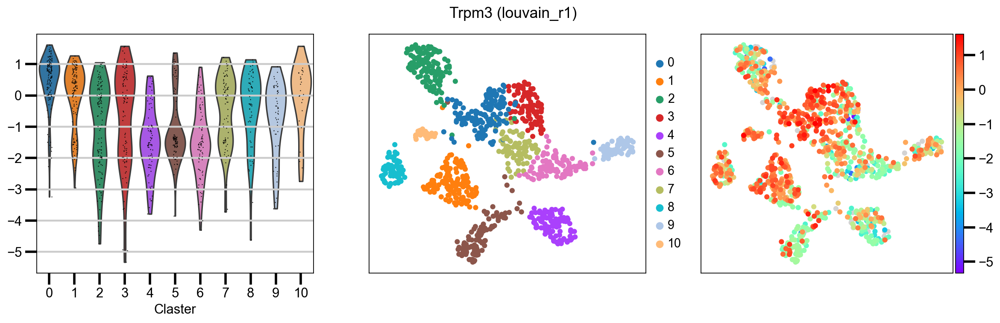

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


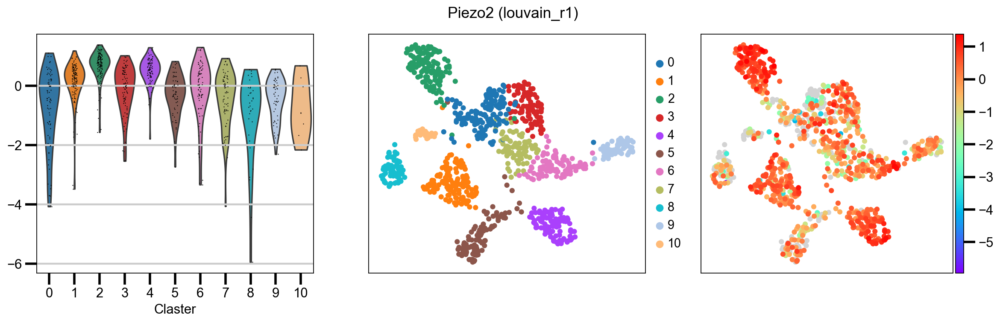

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


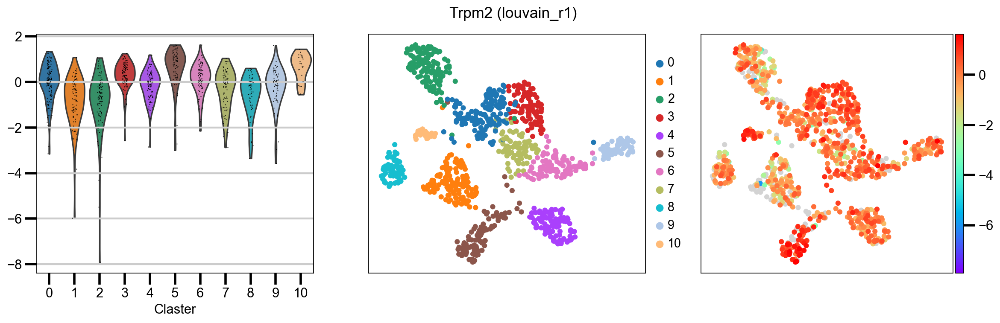

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


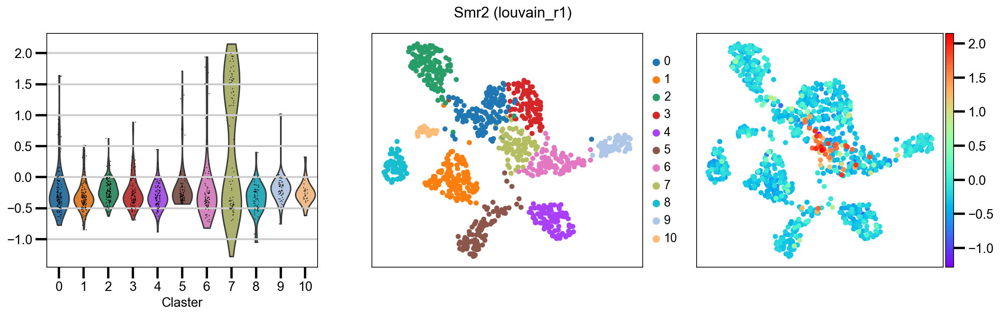

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


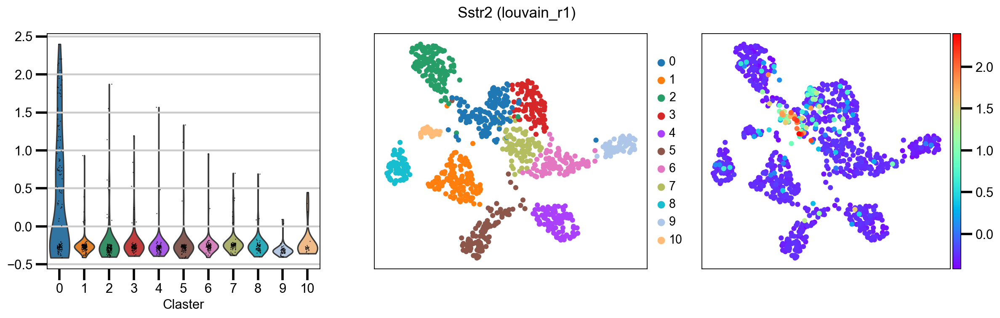

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


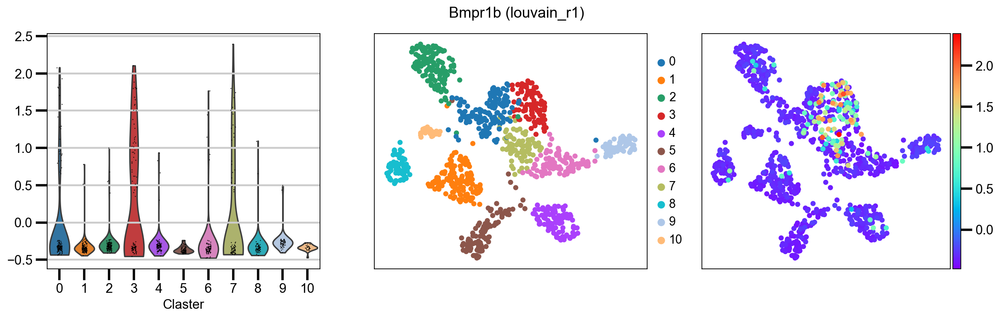

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


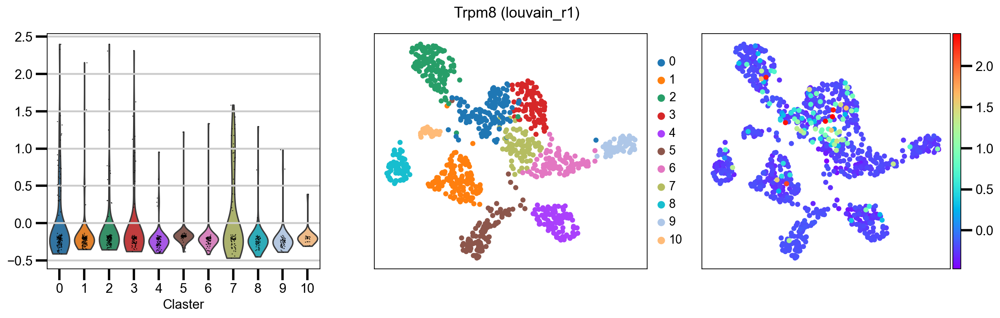

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


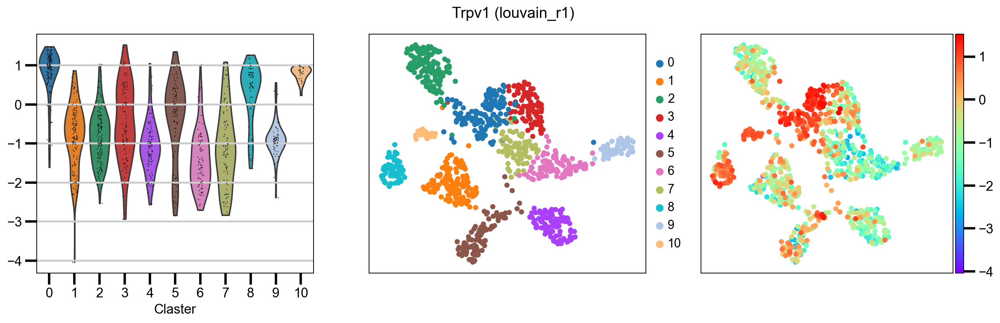

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


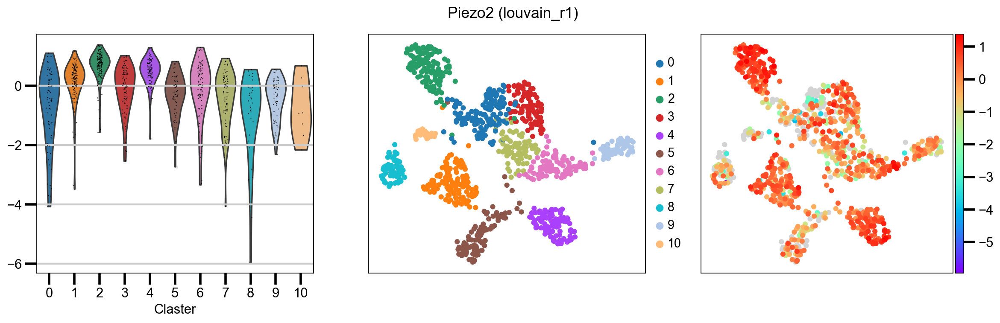

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


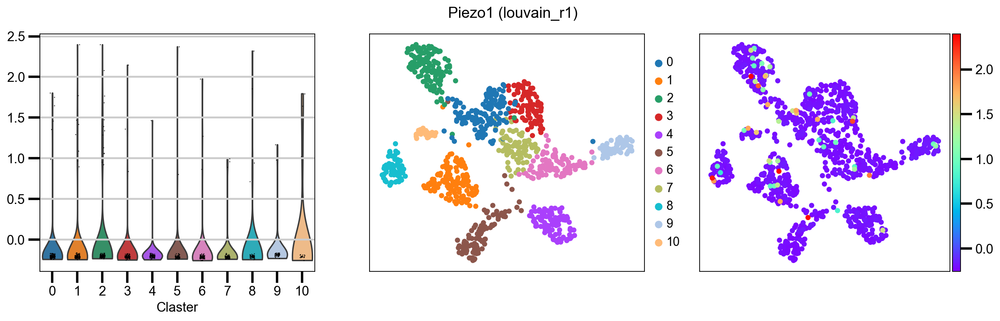

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


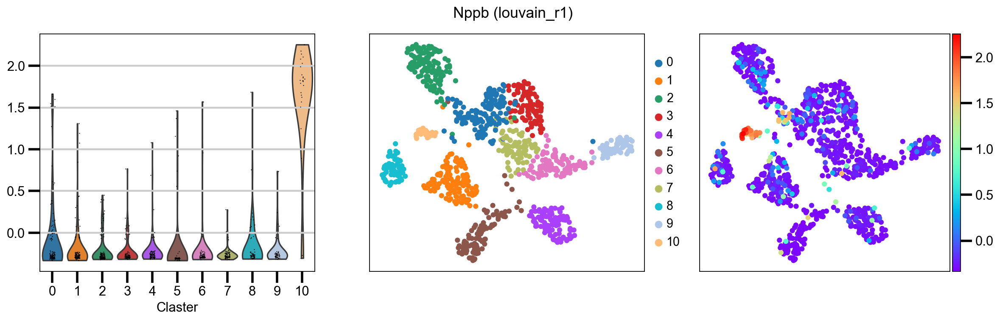

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


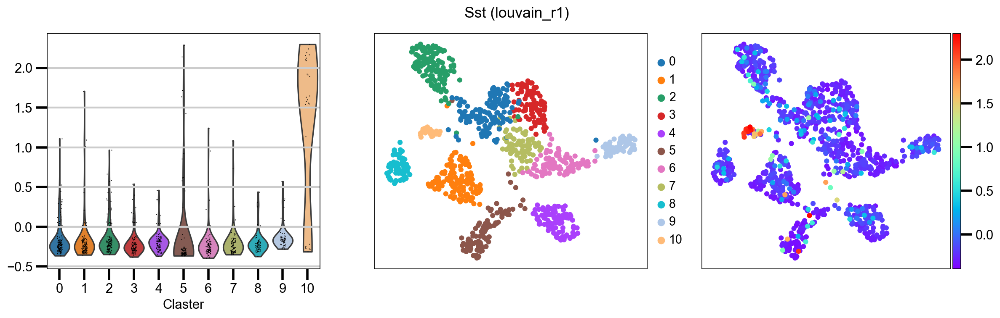

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


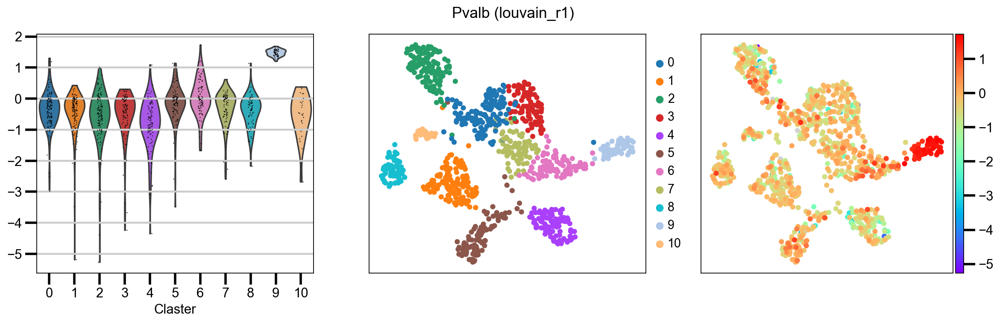

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


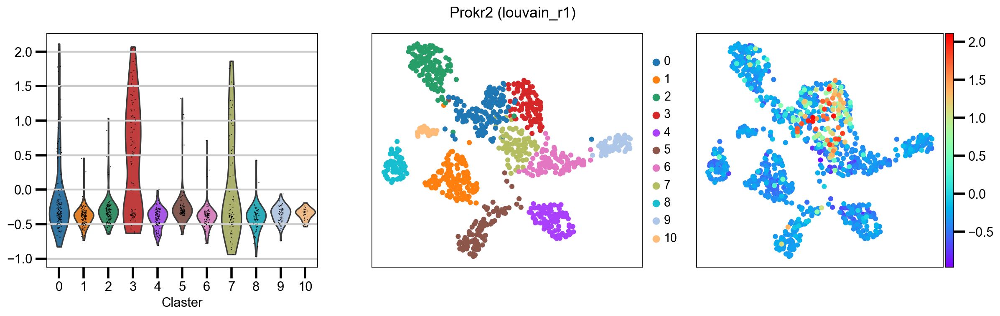

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


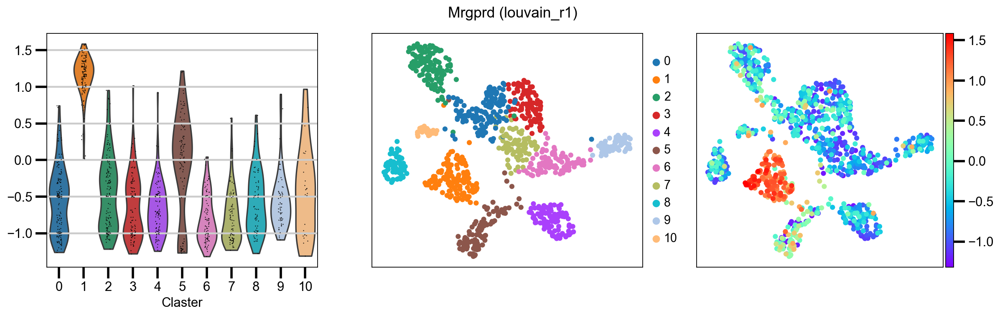

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


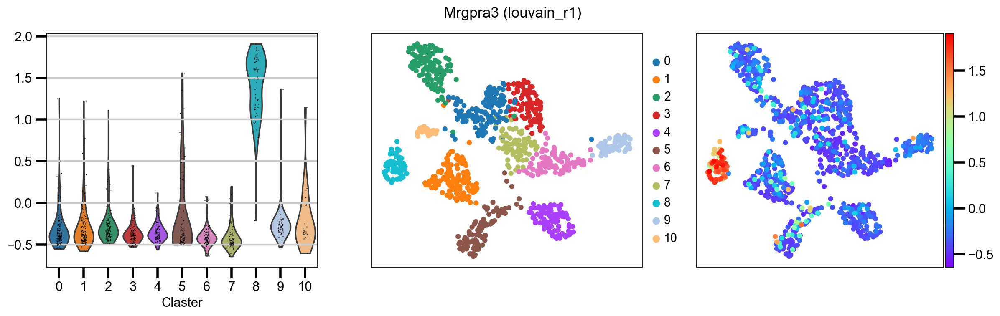

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


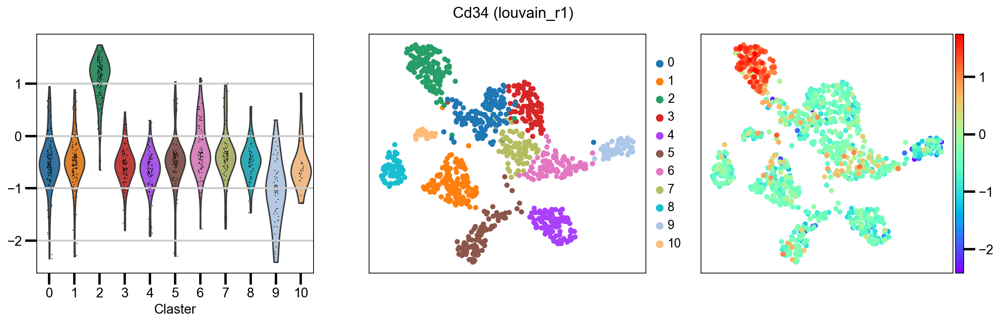

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


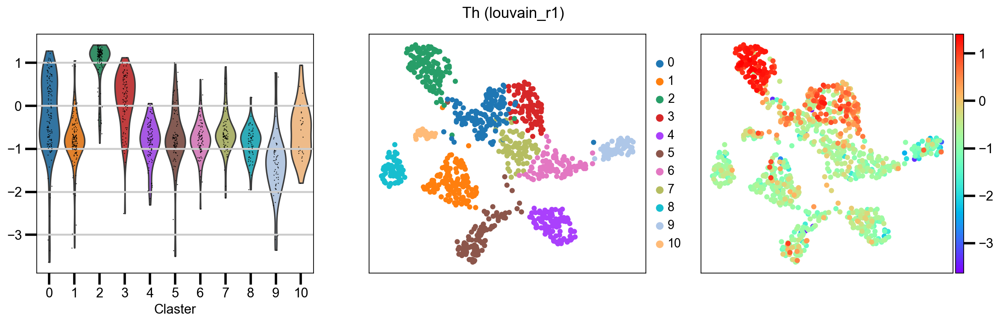

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


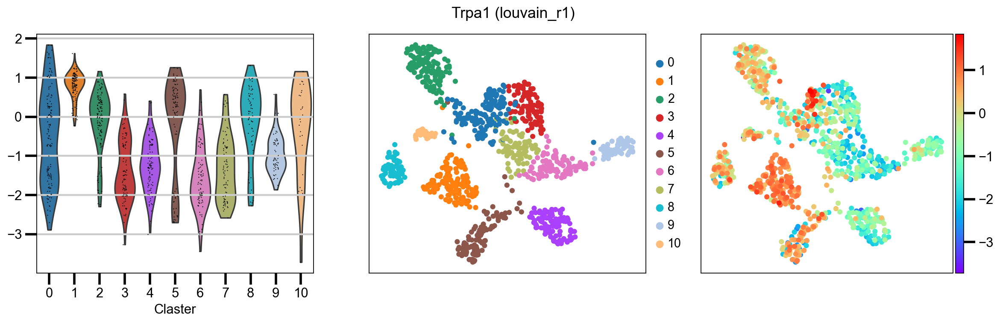

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


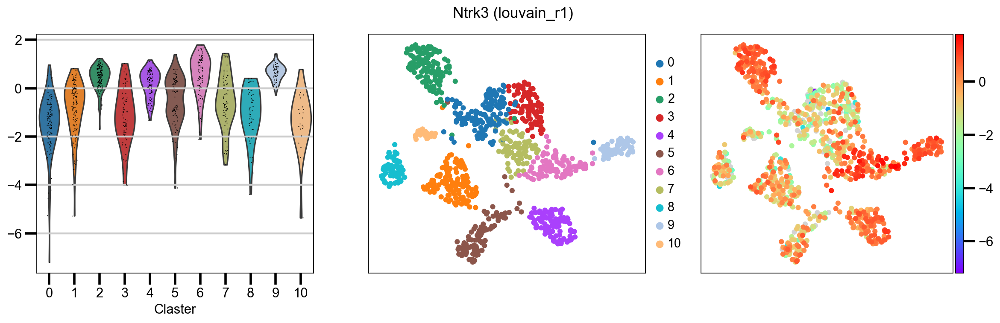

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


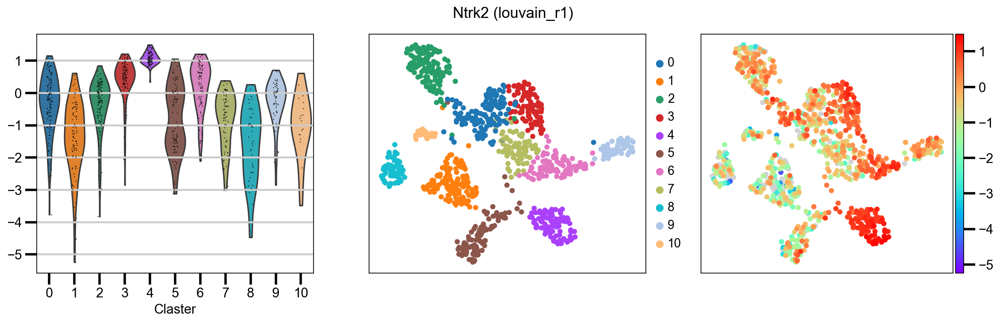

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


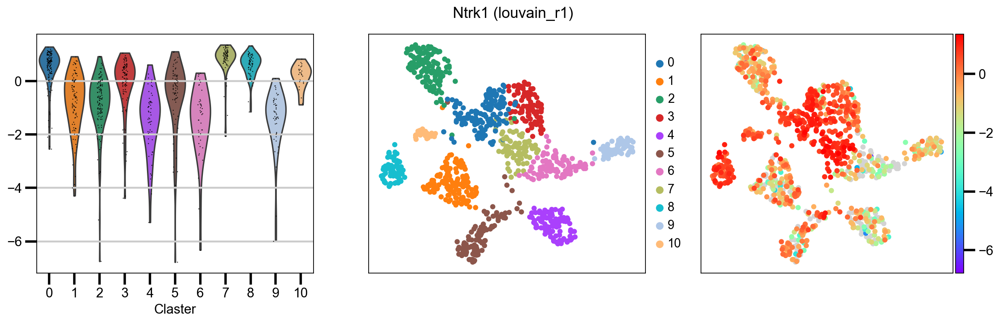

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


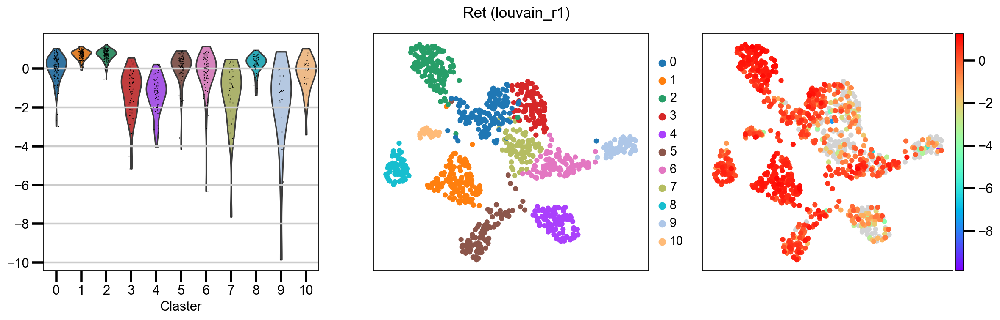

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


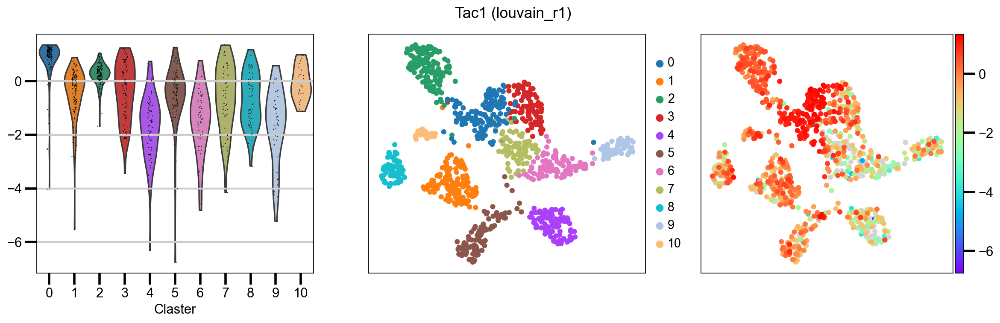

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


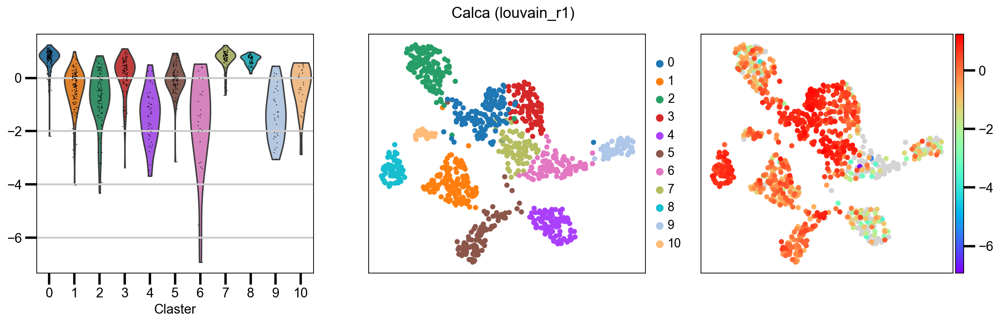

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


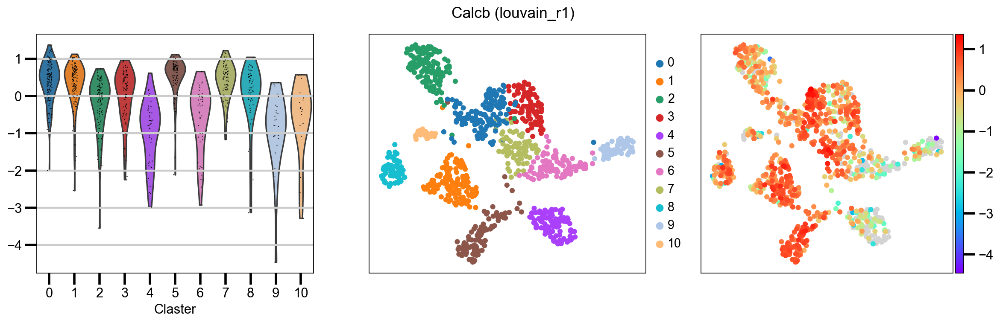

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


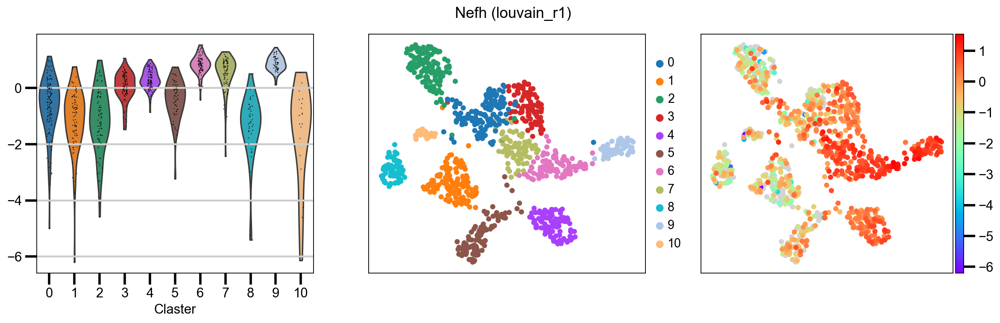

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


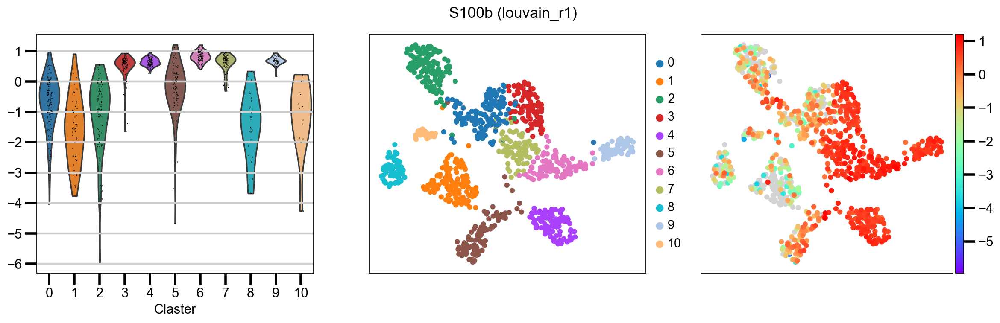

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


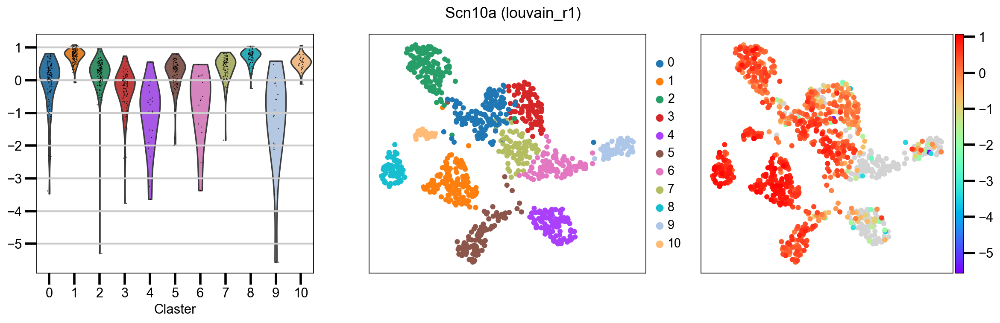

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


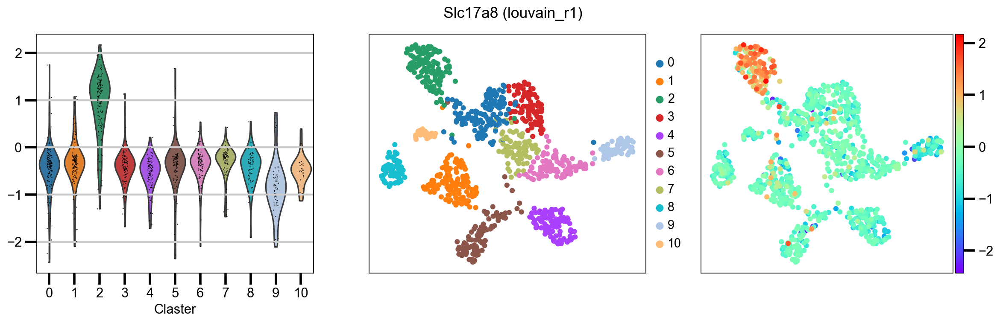

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


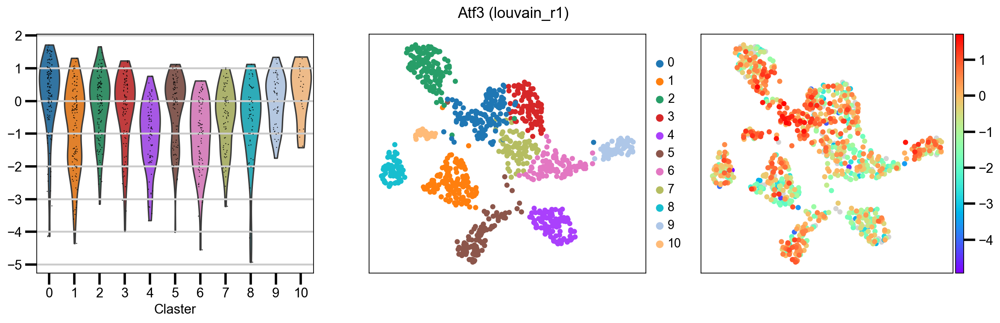

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


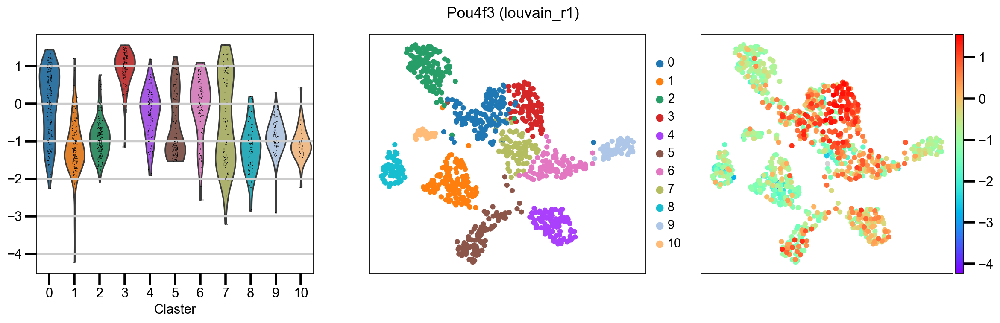

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


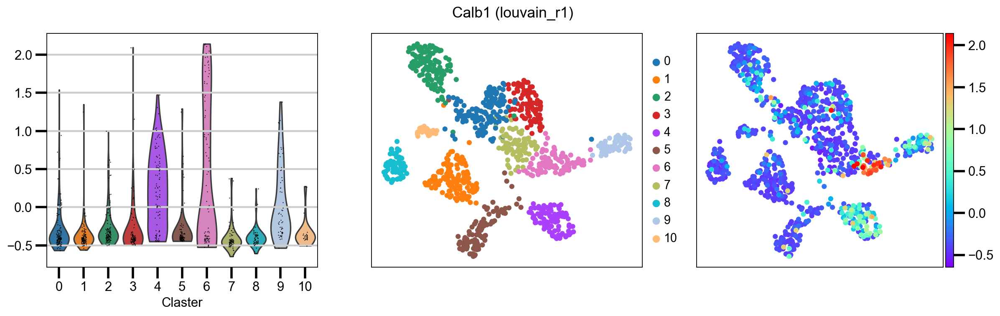

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


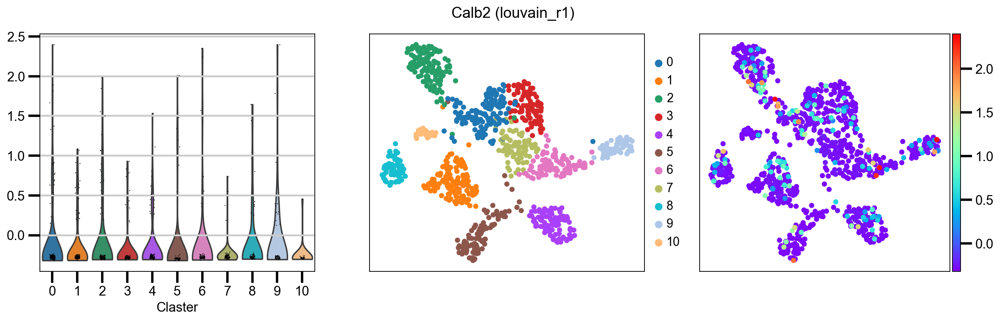

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


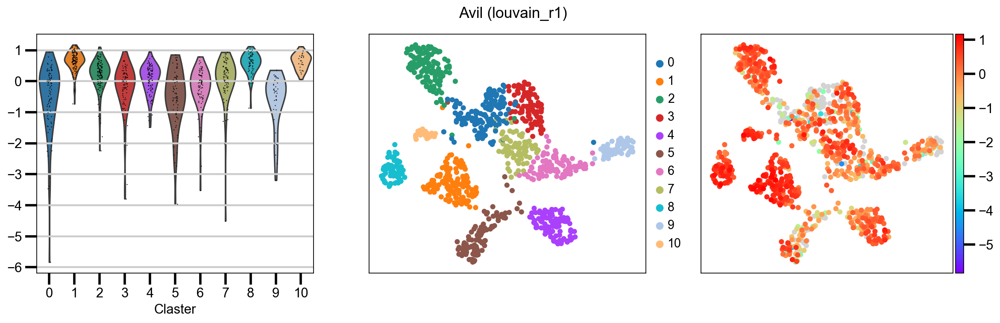

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


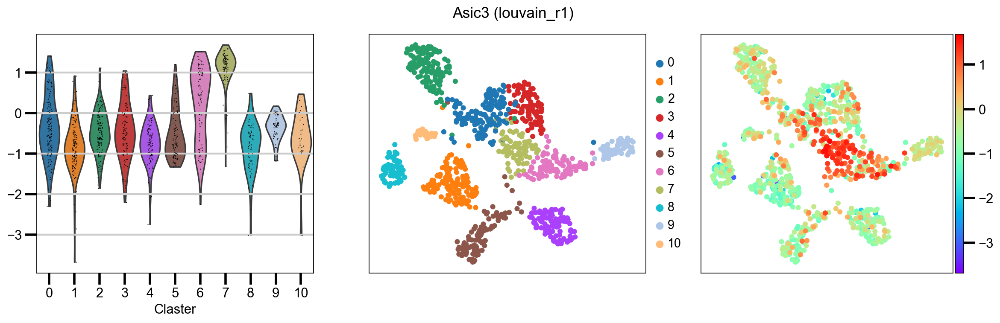

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


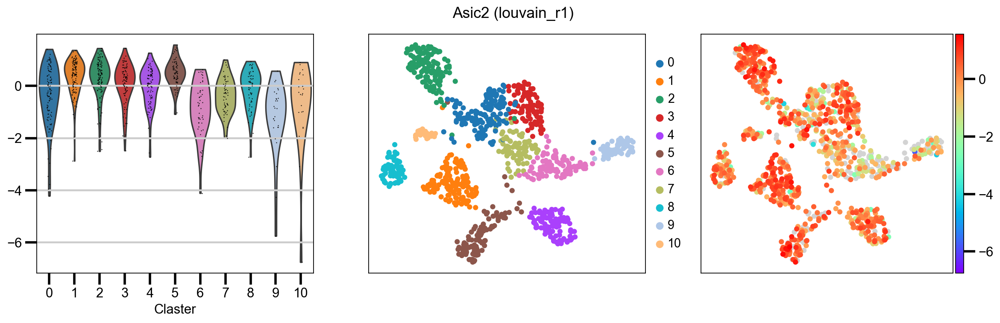

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


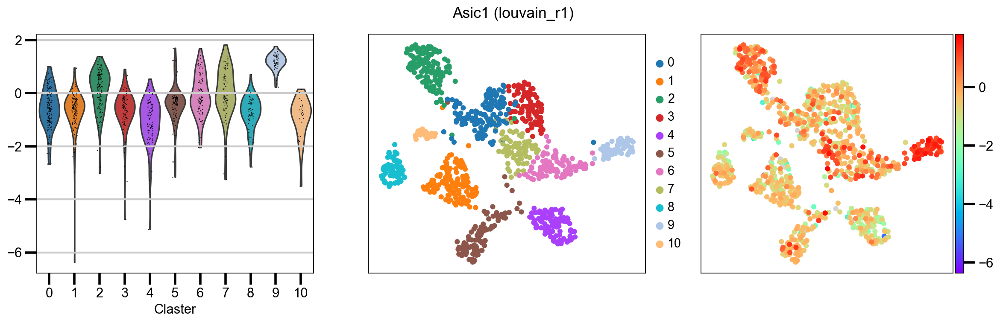

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


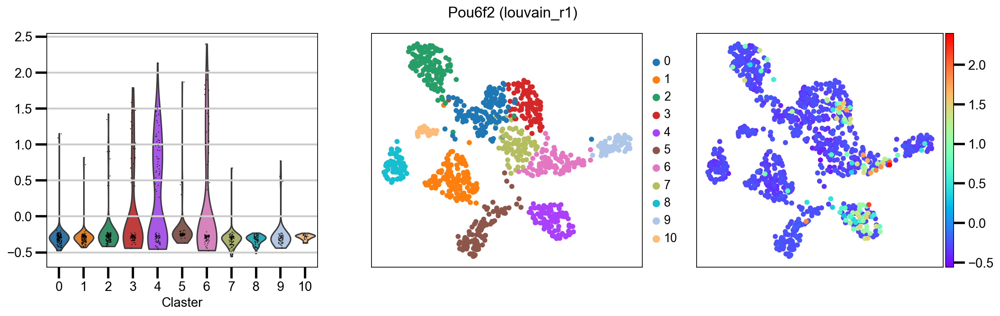

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


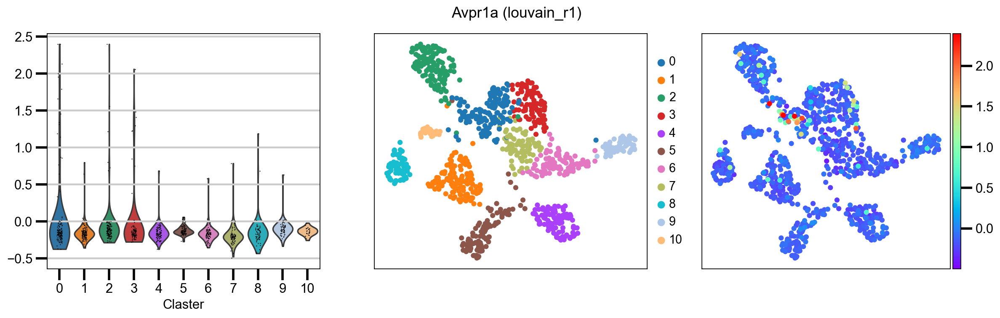

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


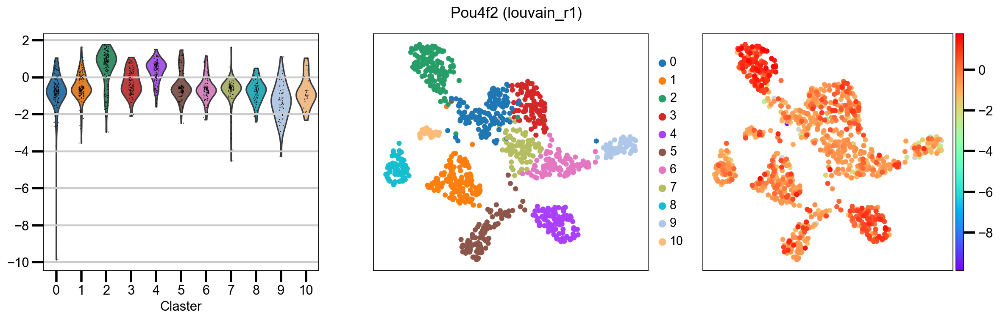

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


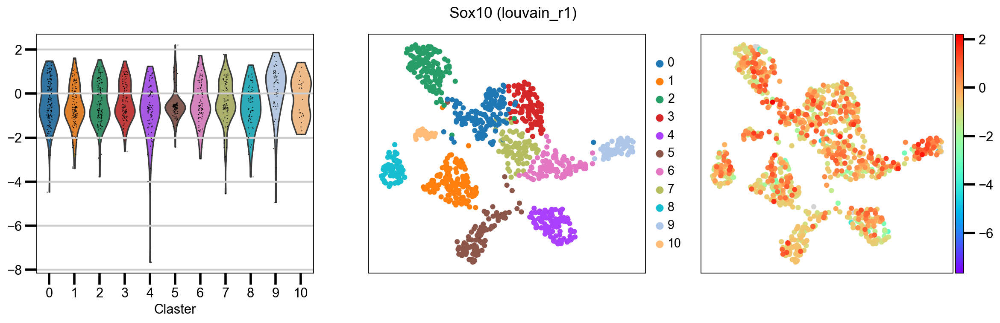

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


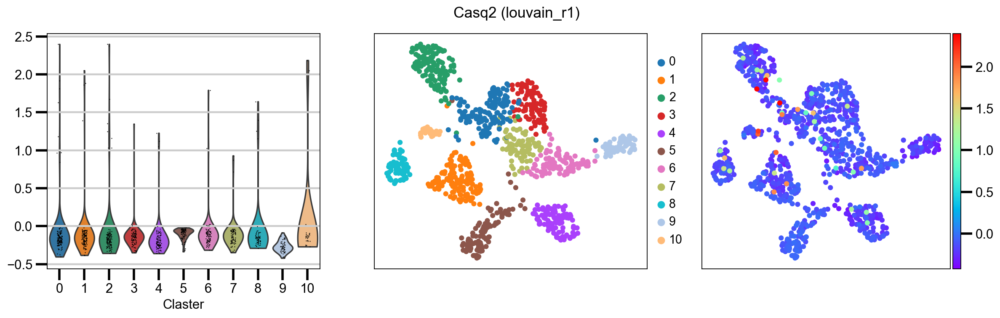

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


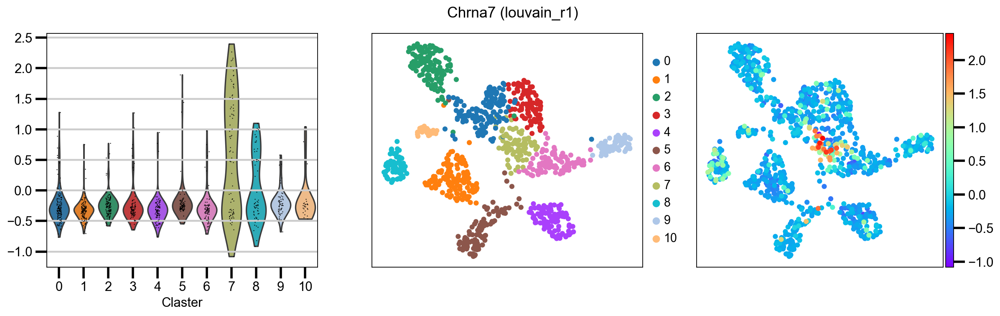

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


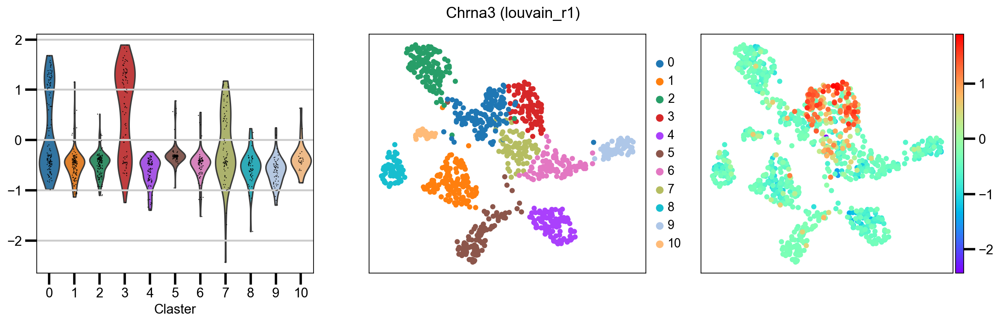

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


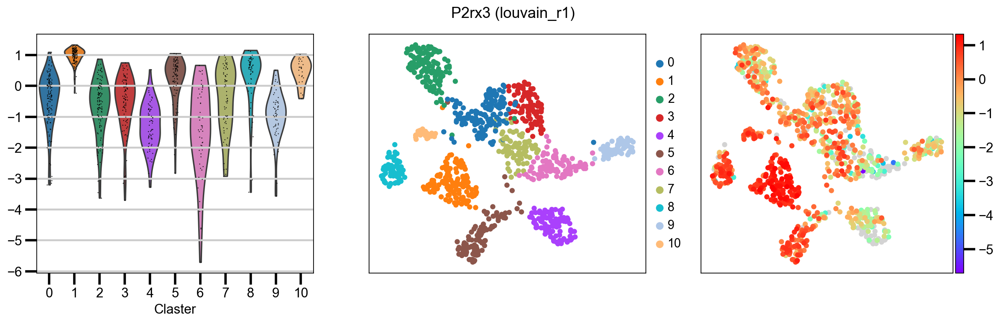

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


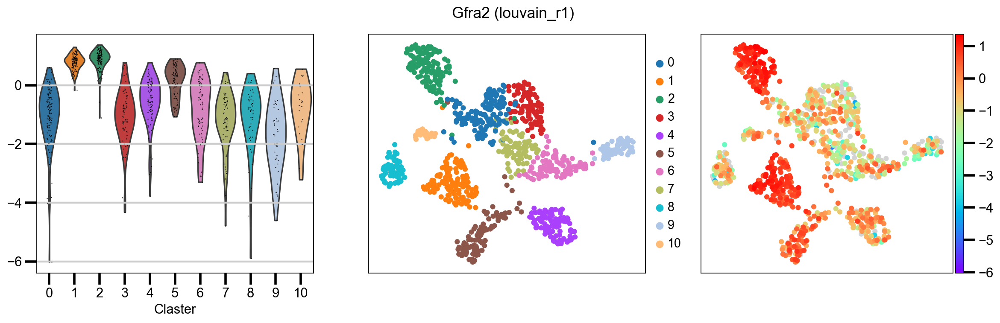

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


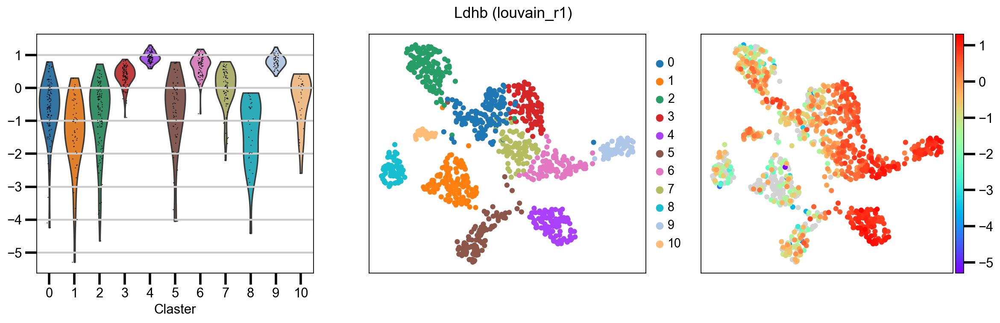

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


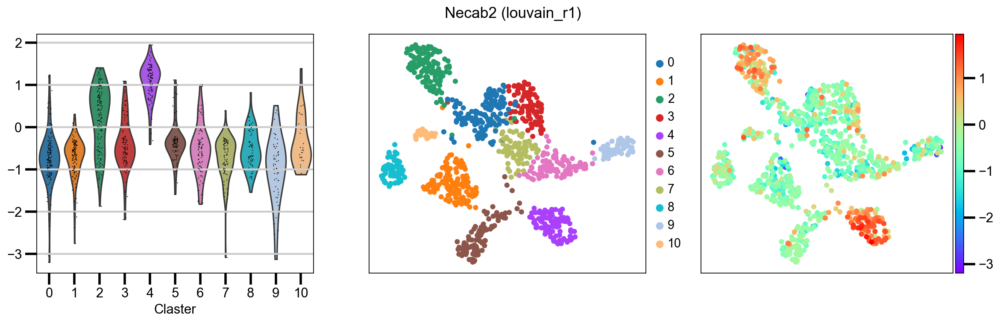

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


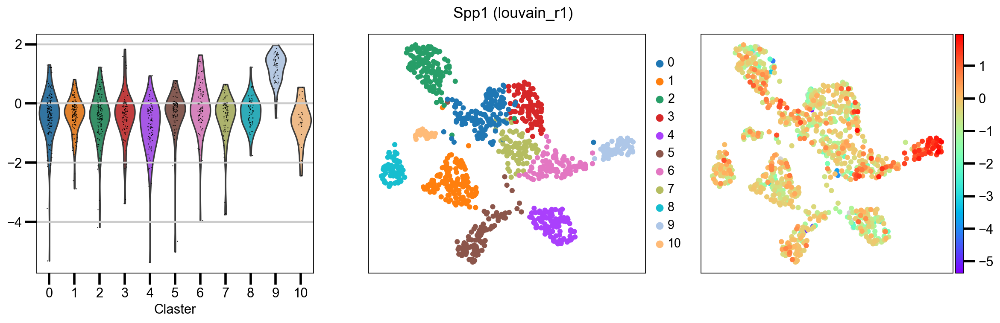

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


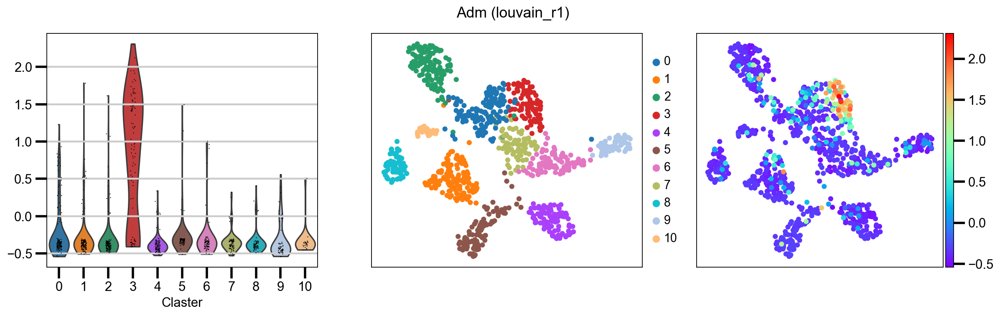

c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


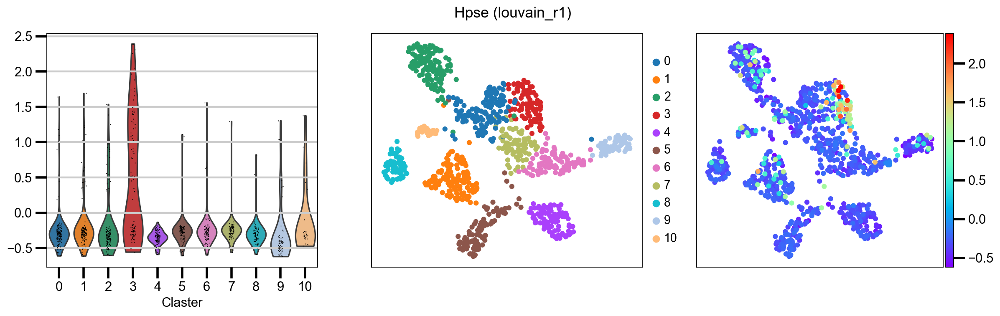

In [86]:
MY_LEFT = 0.09
MY_RIGHT = 0.9
MY_TOP = 0.9
MY_BOTTOM = 0.2
MY_WSPACE = 0.2
MY_HSPACE = 0.5
# Show violin plots next to clasters
# compare a certain gene across clasters
for gene in marker_genes:
    # This produces two Axes objects in a single Figure
    ncols=3
    nrows=1
    figsize=5
    wspace=0.2
    fig,ax = plt.subplots(nrows=nrows, ncols=ncols,
                        figsize=(ncols*figsize+figsize*wspace*(ncols-1),nrows*figsize))
    plt.subplots_adjust(left=MY_LEFT, 
                    bottom=MY_BOTTOM,  
                    right=MY_RIGHT,  
                    top=MY_TOP,  
                    wspace=MY_WSPACE,  
                    hspace=MY_HSPACE)
    fig.suptitle(gene+' ('+SELECTED_LOUVAIN+')\n', fontsize=16)
    # We can use these Axes objects individually to plot on them
    # We need to set show=False so that the Figure is not displayed before we
    # finished plotting on all Axes and making all plot adjustments
    sc.pl.violin(adata_umap, gene, use_raw=False, groupby=SELECTED_LOUVAIN,ax=ax[0],show=False)
    ax[0].set_xlabel("Claster") # change x label from louvain to claster
    ax[0].set_ylabel("")
    sc.pl.umap(adata_umap, color=SELECTED_LOUVAIN, use_raw=False, title='', ax=ax[1],show=False)
    ax[1].set_xlabel("")
    ax[1].set_ylabel("")
    sc.pl.umap(adata_umap, color=gene, use_raw=False, cmap = 'rainbow',title='', ax=ax[2],show=False)
    ax[2].set_xlabel("")
    ax[2].set_ylabel("")
    plt.show()
    fig.savefig(os.path.join(figure_path , 'violin_'+gene+'_'+SELECTED_LOUVAIN+'.png'))

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_louvain_r1']`


c:\Users\ilosz01\.conda\envs\scs\lib\site-packages\scanpy\tools\_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat


categories: 0, 1, 2, etc.
var_group_labels: RA-LTMR, C-LTMR, Itch, etc.


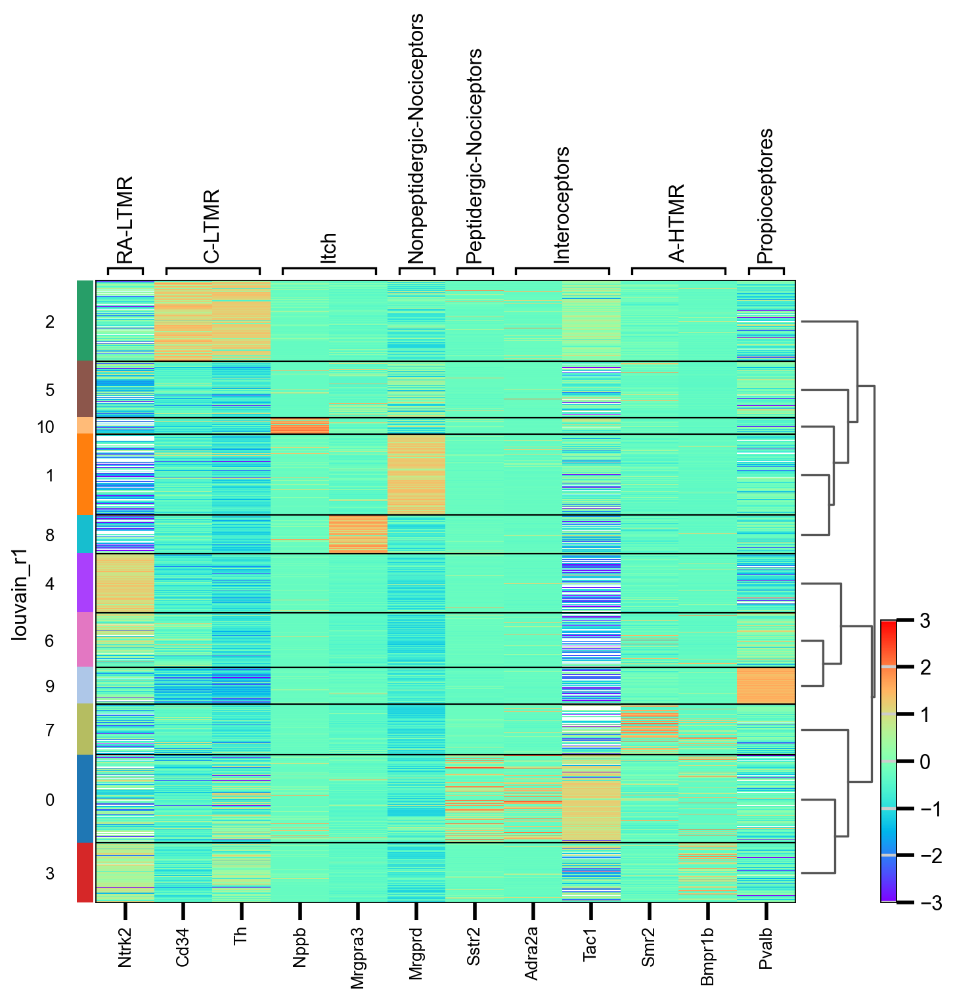

In [87]:
sc.pl.heatmap(adata_umap, marker_genes_dict, groupby=SELECTED_LOUVAIN, cmap='rainbow', use_raw=False, figsize=(10,8), 
              show=True,show_gene_labels=True, dendrogram = True,vmin=-3,vmax=3)

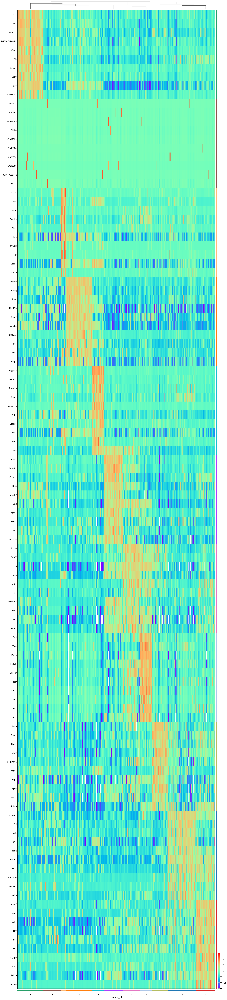

In [88]:
sc.pl.rank_genes_groups_heatmap(adata_umap, n_genes=10, use_raw=False, show_gene_labels=True,swap_axes=True, vmin=-3, vmax=3, cmap='rainbow', figsize=(20,100), show=True, dendrogram = True)